## ライブラリのインポート

In [32]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Input ,Activation,BatchNormalization,Conv2D,MaxPooling2D,UpSampling2D,Reshape,Dropout,Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import callbacks
import random
import math
import diffraction_algos as dalgo
import numpy as np
import matplotlib.pyplot as plt

## ホログラムのパラメータ設定

In [12]:
hs = dalgo.Hologram_Settings((256, 256), 8e-6, 520e-9, 32, 4)

## ランダムな点群データの設定

In [13]:
#点群データの決め方(k：パターン数，p：物体点数)
import random
def pcloudset(k,p):
    data_list = []
    for l in range(k):
        lists = []
        for i in range(p):
            rondom_list = []
            for k in range(2):
                xy = random.uniform(-hs.pp/2*hs.res[0],hs.pp/2*hs.res[1])
                rondom_list.append(xy)
            z = random.uniform(0.5,0.506)
            rondom_list.append(z)
            lists.append(rondom_list)
            pcloud = np.array(lists,dtype = np.float32)
            pcloud += [hs.pp/2*hs.res[0], hs.pp/2*hs.res[1], 0];
        data_list.append(pcloud)
        pcloudset = np.array(data_list)
    return pcloudset

In [9]:
#物体点300点のデータ
x = pcloudset(1000,300)

## ホログラムのデータセット作成(npyファイルにして保存)

In [16]:
list1 = []
list2 = []
list3 = []
list4 = []
for i in range(1000):
    REF = dalgo.reference_fresnel_CGH(res, pp, wlen, x[i])
    REF_real = tf.math.real(REF)
    list1.append(REF_real)
    REF_r = np.array(list1)
    
    REF_imag = tf.math.imag(REF)
    list2.append(REF_imag)
    REF_i = np.array(list2)
    
    APAS = dalgo.accurate_fresnel_stereogram(res, B, F, pp, wlen, x[i])
    APAS = dalgo.inverse_stft(APAS, B)
    
    APAS_real = tf.math.real(APAS)
    list3.append(APAS_real)
    APAS_r = np.array(list3)
    
    APAS_imag = tf.math.imag(APAS)
    list4.append(APAS_imag)
    APAS_i = np.array(list4)

In [31]:
#入力データ(PAS)
X = np.zeros((1000,256,256,2), dtype = np.float32)
X[:,:,:,0] = APAS_r
X[:,:,:,1] = APAS_i
print(X.shape)
#教師データ(CGH)
Y = np.zeros((1000,256,256,2), dtype=np.float32)
Y[:,:,:,0] = REF_r
Y[:,:,:,1] = REF_i
print(Y.shape)
np.save('PAS300data.npy',X)
np.save('CGH300data.npy',Y)

(1000, 256, 256, 2)


## データセットの読み込み

In [5]:
#detasetの読み込み(奥行なし)
y = np.load('PAS300data.npy')
z = np.load('CGH300data.npy')

[[-6.9005223e-04 -1.6224150e-04 -2.9619664e-04 ...  4.2080405e-04
   9.3583437e-04  4.4295518e-04]
 [ 7.2881882e-04  3.8083780e-04 -9.0417714e-05 ... -2.8383709e-04
   3.8151082e-04  5.7982863e-04]
 [ 1.2915953e-03  1.8278277e-04  4.9163739e-04 ... -2.2482514e-04
  -7.0947135e-06  4.4267168e-04]
 ...
 [-2.1522051e-04 -8.1409537e-04 -7.3005888e-04 ...  5.0311945e-05
   2.4466822e-04 -3.2107549e-04]
 [-1.8029907e-04 -1.7359838e-04 -2.2115753e-05 ...  4.1290961e-04
   5.2766132e-05 -5.0355948e-04]
 [-6.3175795e-04 -6.6044647e-04 -1.9905998e-04 ...  1.8145041e-04
  -2.7099493e-04 -4.3007376e-04]]


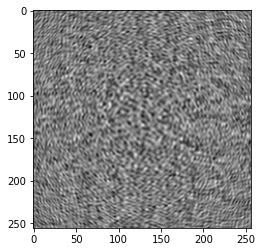

In [6]:
print(y[3,:,:,0])
plt.imshow(y[3,:,:,0], cmap='gray')

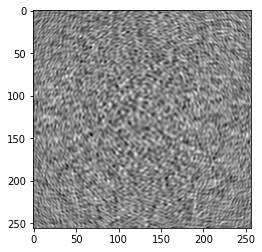

In [7]:
plt.imshow(z[3,:,:,0],cmap='gray')

## データの前処理

In [8]:
#訓練データとテストデータに分ける
X_train , X_test, Y_train, Y_test = y[:800],y[800:], z[:800], z[800:]
print(X_test[0].shape)
print(X_train[:,:,:,0].shape)

(256, 256, 2)
(800, 256, 256)


In [9]:
#データの正規化(実部虚部をそれぞれちゃんと正規化)
for i in range(X_train.shape[0]):
    X_train[i,:,:,0]=(X_train[i,:,:,0]-np.min(X_train[i,:,:,0]))/(np.max(X_train[i,:,:,0])-np.min(X_train[i,:,:,0]))
    X_train[i,:,:,1]=(X_train[i,:,:,1]-np.min(X_train[i,:,:,1]))/(np.max(X_train[i,:,:,1])-np.min(X_train[i,:,:,1]))
    Y_train[i,:,:,0]=(Y_train[i,:,:,0]-np.min(Y_train[i,:,:,0]))/(np.max(Y_train[i,:,:,0])-np.min(Y_train[i,:,:,0]))
    Y_train[i,:,:,1]=(Y_train[i,:,:,1]-np.min(Y_train[i,:,:,1]))/(np.max(Y_train[i,:,:,1])-np.min(Y_train[i,:,:,1]))
for i in range(X_test.shape[0]):
    X_test[i,:,:,0] = (X_test[i,:,:,0]-np.min(X_test[i,:,:,0]))/(np.max(X_test[i,:,:,0])-np.min(X_test[i,:,:,0]))
    X_test[i,:,:,1] = (X_test[i,:,:,1]-np.min(X_test[i,:,:,1]))/(np.max(X_test[i,:,:,1])-np.min(X_test[i,:,:,1]))
    Y_test[i,:,:,0] = (Y_test[i,:,:,0]-np.min(Y_test[i,:,:,0]))/(np.max(Y_test[i,:,:,0])-np.min(Y_test[i,:,:,0]))
    Y_test[i,:,:,1] = (Y_test[i,:,:,1]-np.min(Y_test[i,:,:,1]))/(np.max(Y_test[i,:,:,1])-np.min(Y_test[i,:,:,1]))

## モデルの構築

In [19]:
#ニューラルネットワーク
def UNet():
    ##256x256x2
    inputs = Input(shape=(256,256,2))
    
    ##256x256x64
    z1 = Conv2D(64,(3,3),name='block1_conv1',activation='relu',padding = 'same')(inputs)
    z1 = Conv2D(64,(3,3),name='block1_conv2',padding = 'same') (z1)
    z1 = BatchNormalization()(z1)
    z1 = Activation('relu')(z1)
    z1_pool = MaxPooling2D((2,2), strides=None, name='block1_pool')(z1)
    
    ##128x128x128
    z2 = Conv2D(128,(3,3),name='block2_conv1',activation='relu',padding = 'same')(z1_pool)
    z2 = Conv2D(128,(3,3) , name='block2_conv2', padding = 'same')(z2)
    z2 = BatchNormalization()(z2)
    z2 = Activation('relu')(z2)
    z2_pool = MaxPooling2D((2,2), strides=None, name='block2_pool')(z2)
    
    ##64x64x256
    z3 = Conv2D(256, (3, 3) , name='block3_conv1', activation = 'relu', padding = 'same')(z2_pool)
    z3 = Conv2D(256, (3, 3) , name='block3_conv2', padding = 'same')(z3)
    z3 = BatchNormalization()(z3)
    z3 = Activation('relu')(z3)
    z3_pool = MaxPooling2D((2,2), strides=None, name='block3_pool')(z3)
    
    ##32x32x512
    z4 = Conv2D(512, (3, 3) , name='block4_conv1', activation = 'relu', padding = 'same')(z3_pool)
    z4 = Conv2D(512, (3, 3) , name='block4_conv2', padding = 'same')(z4)
    z4 = BatchNormalization()(z4)
    z4 = Activation('relu')(z4)
    z4_dropout = Dropout(0.5)(z4)
    z4_pool = MaxPooling2D((2,2), strides=None, name='block4_pool')(z4_dropout)
    
    #16x16x1024
    z5 = Conv2D(1024, (3, 3) , name='block5_conv1', activation = 'relu', padding = 'same')(z4_pool)
    z5 = Conv2D(1024, (3, 3) , name='block5_conv2', padding = 'same')(z5)
    z5 = BatchNormalization()(z5)
    z5 = Activation('relu')(z5)
    z5_dropout = Dropout(0.5)(z5)
    
    ##32x32x512
    z6_up = UpSampling2D((2,2))(z5_dropout)
    z6 = Conv2D(512, (2, 2) , name='block6_conv1', activation = 'relu', padding = 'same')(z6_up)
    z6 = Concatenate()([z4_dropout,z6])
    z6 = Conv2D(512, (3, 3) , name='block6_conv2', activation = 'relu', padding = 'same')(z6)
    z6 = Conv2D(512, (3, 3) , name='block6_conv3', padding = 'same')(z6)
    z6 = BatchNormalization()(z6)
    z6 = Activation('relu')(z6)
    
    ##64x64x256
    z7_up = UpSampling2D((2,2))(z6)
    z7 = Conv2D(256, (2, 2) , name='block7_conv1', activation = 'relu', padding = 'same')(z7_up)
    #z7 = concatenate([z3,z7], axis =3)
    z7 = Concatenate()([z3,z7])
    z7 = Conv2D(256, (3, 3) , name='block7_conv2', activation = 'relu', padding = 'same')(z7)
    z7 = Conv2D(256, (3, 3) , name='block7_conv3', padding = 'same')(z7)
    z7 = BatchNormalization()(z7)
    z7 = Activation('relu')(z7)
    
    ##128x128x128
    z8_up = UpSampling2D((2,2))(z7)
    z8 = Conv2D(128, (2, 2) , name='block8_conv1', activation = 'relu', padding = 'same')(z8_up)
    #z8 = concatenate([z2,z8], axis = 3)
    z8 = Concatenate()([z2,z8])
    z8 = Conv2D(128, (3, 3) , name='block8_conv2', activation = 'relu', padding = 'same')(z8)
    z8 = Conv2D(128, (3, 3) , name='block8_conv3', padding = 'same')(z8)
    z8 = BatchNormalization()(z8)
    z8 = Activation('relu')(z8)
    
    ##256x256x64
    z9_up = UpSampling2D((2,2))(z8)
    z9 = Conv2D(64, (2, 2) , name='block9_conv1', activation = 'relu', padding = 'same')(z9_up)
    #z9 = concatenate([z1,z9], axis = 3)
    z9 = Concatenate()([z1,z9])
    z9 = Conv2D(64, (3, 3) , name='block9_conv2', activation = 'relu', padding = 'same')(z9)
    z9 = Conv2D(64, (3, 3) , name='block9_conv3', padding = 'same')(z9)
    z9 = BatchNormalization()(z9)
    z9 = Activation('relu')(z9)
    
    #256x256x2
    output = Conv2D(2, (1, 1), name='output_conv', activation = 'sigmoid')(z9)
    
    model = Model(inputs = inputs, outputs = output)
    return model

### MaxpoolingとUpSamplingを使わないモデル

In [ ]:
def UNet():
    ##256x256x2
    inputs = Input(shape=(256,256,2))
    
    ##256x256x64
    z1 = Conv2D(64,(3,3),name='block1_conv1',activation='relu',padding = 'same')(inputs)
    z1 = Conv2D(64,(3,3),name='block1_conv2',padding = 'same') (z1)
    z1 = BatchNormalization()(z1)
    z1 = Activation('relu')(z1)
    z1_pool = MaxPooling2D((2,2), strides=None, name='block1_pool')(z1)
    
    ##128x128x128
    z2 = Conv2D(128,(3,3),name='block2_conv1',activation='relu',padding = 'same')(z1_pool)
    z2 = Conv2D(128,(3,3) , name='block2_conv2', padding = 'same')(z2)
    z2 = BatchNormalization()(z2)
    z2 = Activation('relu')(z2)
    z2_pool = MaxPooling2D((2,2), strides=None, name='block2_pool')(z2)
    
    ##64x64x256
    z3 = Conv2D(256, (3, 3) , name='block3_conv1', activation = 'relu', padding = 'same')(z2_pool)
    z3 = Conv2D(256, (3, 3) , name='block3_conv2', padding = 'same')(z3)
    z3 = BatchNormalization()(z3)
    z3 = Activation('relu')(z3)
    z3_pool = MaxPooling2D((2,2), strides=None, name='block3_pool')(z3)
    
    ##32x32x512
    z4 = Conv2D(512, (3, 3) , name='block4_conv1', activation = 'relu', padding = 'same')(z3_pool)
    z4 = Conv2D(512, (3, 3) , name='block4_conv2', padding = 'same')(z4)
    z4 = BatchNormalization()(z4)
    z4 = Activation('relu')(z4)
    z4_dropout = Dropout(0.5)(z4)
    z4_pool = MaxPooling2D((2,2), strides=None, name='block4_pool')(z4_dropout)
    
    #16x16x1024
    z5 = Conv2D(1024, (3, 3) , name='block5_conv1', activation = 'relu', padding = 'same')(z4_pool)
    z5 = Conv2D(1024, (3, 3) , name='block5_conv2', padding = 'same')(z5)
    z5 = BatchNormalization()(z5)
    z5 = Activation('relu')(z5)
    z5_dropout = Dropout(0.5)(z5)
    
    ##32x32x512
    z6_up = UpSampling2D((2,2))(z5_dropout)
    z6 = Conv2D(512, (2, 2) , name='block6_conv1', activation = 'relu', padding = 'same')(z6_up)
    z6 = Concatenate()([z4_dropout,z6])
    z6 = Conv2D(512, (3, 3) , name='block6_conv2', activation = 'relu', padding = 'same')(z6)
    z6 = Conv2D(512, (3, 3) , name='block6_conv3', padding = 'same')(z6)
    z6 = BatchNormalization()(z6)
    z6 = Activation('relu')(z6)
    
    ##64x64x256
    z7_up = UpSampling2D((2,2))(z6)
    z7 = Conv2D(256, (2, 2) , name='block7_conv1', activation = 'relu', padding = 'same')(z7_up)
    #z7 = concatenate([z3,z7], axis =3)
    z7 = Concatenate()([z3,z7])
    z7 = Conv2D(256, (3, 3) , name='block7_conv2', activation = 'relu', padding = 'same')(z7)
    z7 = Conv2D(256, (3, 3) , name='block7_conv3', padding = 'same')(z7)
    z7 = BatchNormalization()(z7)
    z7 = Activation('relu')(z7)
    
    ##128x128x128
    z8_up = UpSampling2D((2,2))(z7)
    z8 = Conv2D(128, (2, 2) , name='block8_conv1', activation = 'relu', padding = 'same')(z8_up)
    #z8 = concatenate([z2,z8], axis = 3)
    z8 = Concatenate()([z2,z8])
    z8 = Conv2D(128, (3, 3) , name='block8_conv2', activation = 'relu', padding = 'same')(z8)
    z8 = Conv2D(128, (3, 3) , name='block8_conv3', padding = 'same')(z8)
    z8 = BatchNormalization()(z8)
    z8 = Activation('relu')(z8)
    
    ##256x256x64
    z9_up = UpSampling2D((2,2))(z8)
    z9 = Conv2D(64, (2, 2) , name='block9_conv1', activation = 'relu', padding = 'same')(z9_up)
    #z9 = concatenate([z1,z9], axis = 3)
    z9 = Concatenate()([z1,z9])
    z9 = Conv2D(64, (3, 3) , name='block9_conv2', activation = 'relu', padding = 'same')(z9)
    z9 = Conv2D(64, (3, 3) , name='block9_conv3', padding = 'same')(z9)
    z9 = BatchNormalization()(z9)
    z9 = Activation('relu')(z9)
    
    #256x256x2
    output = Conv2D(2, (1, 1), name='output_conv', activation = 'sigmoid')(z9)
    
    model = Model(inputs = inputs, outputs = output)
    return model

## モデル学習

３２枚→最大512枚

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 32  608         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 32  9248        ['block1_conv1[0][0]']           
                                )                                                             

                                                                                                  
 activation_5 (Activation)      (None, 32, 32, 256)  0           ['batch_normalization_5[0][0]']  
                                                                                                  
 up_sampling2d_1 (UpSampling2D)  (None, 64, 64, 256)  0          ['activation_5[0][0]']           
                                                                                                  
 block7_conv1 (Conv2D)          (None, 64, 64, 128)  131200      ['up_sampling2d_1[0][0]']        
                                                                                                  
 concatenate_1 (Concatenate)    (None, 64, 64, 256)  0           ['activation_2[0][0]',           
                                                                  'block7_conv1[0][0]']           
                                                                                                  
 block7_co

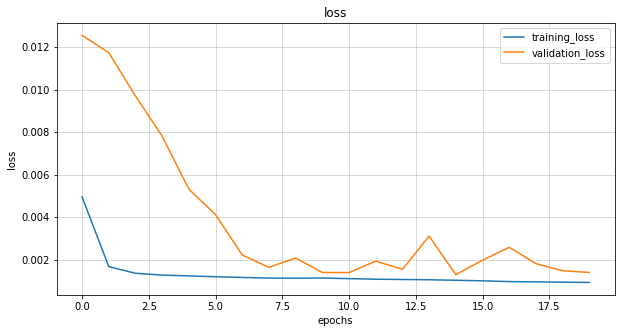

In [9]:
#UNet 結果(パラメータ多すぎて過学習気味)
model = UNet()
print(model.summary())
#adam = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 10,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()

16枚→256枚

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 16  304         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 16  2320        ['block1_conv1[0][0]']           
                                )                                                           

                                                                                                  
 activation_14 (Activation)     (None, 32, 32, 128)  0           ['batch_normalization_14[0][0]'] 
                                                                                                  
 up_sampling2d_5 (UpSampling2D)  (None, 64, 64, 128)  0          ['activation_14[0][0]']          
                                                                                                  
 block7_conv1 (Conv2D)          (None, 64, 64, 64)   32832       ['up_sampling2d_5[0][0]']        
                                                                                                  
 concatenate_5 (Concatenate)    (None, 64, 64, 128)  0           ['activation_11[0][0]',          
                                                                  'block7_conv1[0][0]']           
                                                                                                  
 block7_co

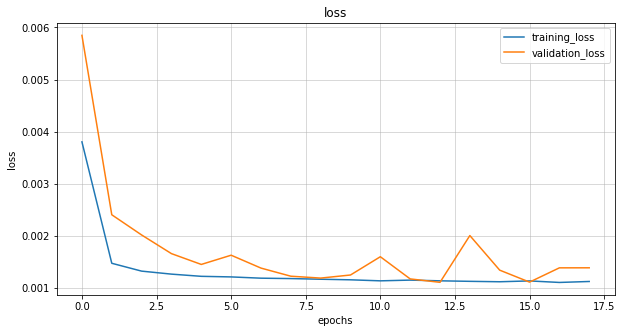

In [10]:
model = UNet()
print(model.summary())
#adam = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=30,batch_size = 2,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()

5×5の畳み込みフィルタにした結果

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  3264        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  102464      ['block1_conv1[0][0]']           
                                )                                                             

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  6554112     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_5 (BatchNo  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 rmalization)                                                                                     
                                                                                                  
 activation_5 (Activation)      (None, 32, 32, 512)  0           ['batch_normalization_5[0][0]']  
                                                                                                  
 up_sampling2d_1 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_5[0][0]']           
                                                                                                  
 block7_co

400/400 [==============================] - 112s 281ms/step - loss: 0.0012 - accuracy: 0.9113 - val_loss: 0.0033 - val_accuracy: 0.8559
Epoch 10/20
400/400 [==============================] - 112s 280ms/step - loss: 0.0012 - accuracy: 0.9104 - val_loss: 0.0020 - val_accuracy: 0.8816


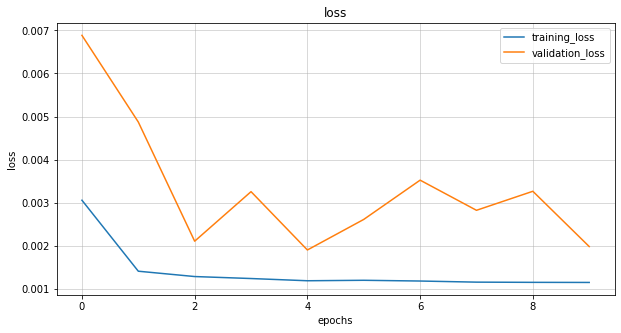

In [8]:
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 2,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()

パラメータ減らした場合，10エポック目でエラー

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_6[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                           

 ormalization)                                                                                    
                                                                                                  
 activation_43 (Activation)     (None, 32, 32, 512)  0           ['batch_normalization_44[0][0]'] 
                                                                                                  
 up_sampling2d_16 (UpSampling2D  (None, 64, 64, 512)  0          ['activation_43[0][0]']          
 )                                                                                                
                                                                                                  
 block7_conv1 (Conv2D)          (None, 64, 64, 256)  524544      ['up_sampling2d_16[0][0]']       
                                                                                                  
 concatenate_16 (Concatenate)   (None, 64, 64, 512)  0           ['activation_40[0][0]',          
          

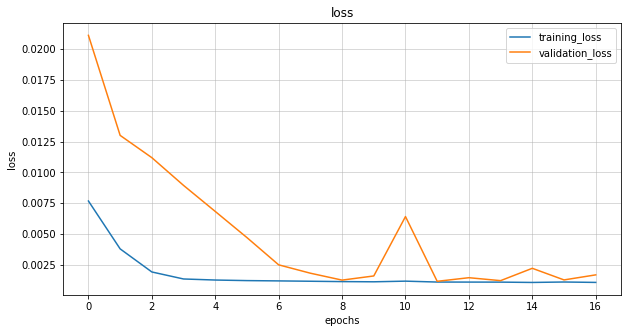

In [17]:
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 10,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                             

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_5 (BatchNo  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 rmalization)                                                                                     
                                                                                                  
 activation_5 (Activation)      (None, 32, 32, 512)  0           ['batch_normalization_5[0][0]']  
                                                                                                  
 up_sampling2d_1 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_5[0][0]']           
                                                                                                  
 block7_co

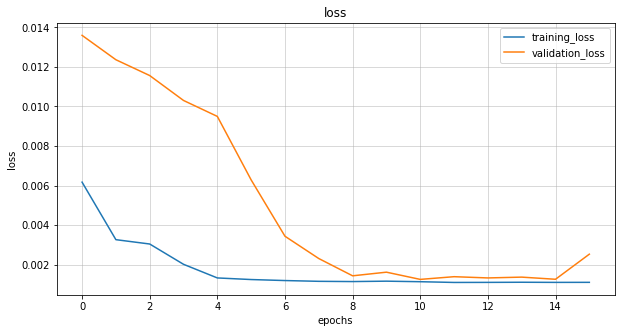

In [10]:
#UNet 結果(パラメータ多すぎて過学習気味)
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['mean_squared_error'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 10,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()

#上のモデルのバッチサイズを減らす

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                             

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_5 (BatchNo  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 rmalization)                                                                                     
                                                                                                  
 activation_5 (Activation)      (None, 32, 32, 512)  0           ['batch_normalization_5[0][0]']  
                                                                                                  
 up_sampling2d_1 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_5[0][0]']           
                                                                                                  
 block7_co

80/80 [==============================] - 68s 852ms/step - loss: 6.3506e-04 - accuracy: 0.9372 - val_loss: 0.0012 - val_accuracy: 0.9139
Epoch 65/100
80/80 [==============================] - 68s 851ms/step - loss: 6.2058e-04 - accuracy: 0.9373 - val_loss: 0.0016 - val_accuracy: 0.9012
Epoch 66/100
80/80 [==============================] - 68s 852ms/step - loss: 6.2749e-04 - accuracy: 0.9367 - val_loss: 0.0019 - val_accuracy: 0.8671
Epoch 67/100
80/80 [==============================] - 68s 852ms/step - loss: 6.3685e-04 - accuracy: 0.9365 - val_loss: 0.0023 - val_accuracy: 0.8399
Epoch 68/100
80/80 [==============================] - 68s 851ms/step - loss: 6.3280e-04 - accuracy: 0.9376 - val_loss: 0.0011 - val_accuracy: 0.9155
Epoch 69/100
80/80 [==============================] - 68s 852ms/step - loss: 6.2369e-04 - accuracy: 0.9376 - val_loss: 0.0014 - val_accuracy: 0.8983
Epoch 70/100
80/80 [==============================] - 68s 852ms/step - loss: 6.2944e-04 - accuracy: 0.9367 - val_loss: 

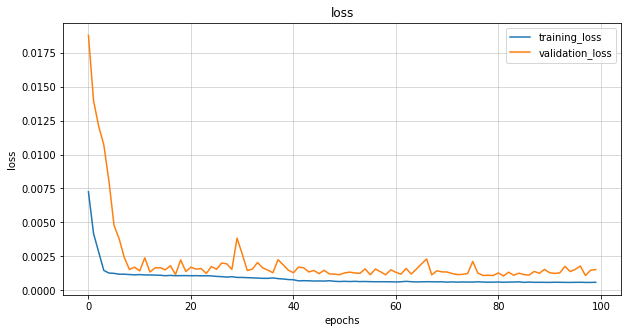

In [9]:
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=100,batch_size = 10,validation_data=(X_test, Y_test),)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()

上の学習率を1/10

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                           

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_14 (BatchN  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 ormalization)                                                                                    
                                                                                                  
 activation_14 (Activation)     (None, 32, 32, 512)  0           ['batch_normalization_14[0][0]'] 
                                                                                                  
 up_sampling2d_5 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_14[0][0]']          
                                                                                                  
 block7_co

80/80 [==============================] - 68s 852ms/step - loss: 6.2447e-04 - accuracy: 0.9365 - val_loss: 0.0012 - val_accuracy: 0.9137
Epoch 65/100
80/80 [==============================] - 68s 852ms/step - loss: 6.0980e-04 - accuracy: 0.9375 - val_loss: 0.0011 - val_accuracy: 0.9138
Epoch 66/100
80/80 [==============================] - 68s 852ms/step - loss: 6.0799e-04 - accuracy: 0.9381 - val_loss: 0.0013 - val_accuracy: 0.9084
Epoch 67/100
80/80 [==============================] - 68s 852ms/step - loss: 6.0874e-04 - accuracy: 0.9380 - val_loss: 0.0016 - val_accuracy: 0.8927
Epoch 68/100
80/80 [==============================] - 68s 852ms/step - loss: 6.1962e-04 - accuracy: 0.9367 - val_loss: 0.0011 - val_accuracy: 0.9147
Epoch 69/100
80/80 [==============================] - 68s 852ms/step - loss: 6.0629e-04 - accuracy: 0.9375 - val_loss: 0.0012 - val_accuracy: 0.9118
Epoch 70/100
80/80 [==============================] - 68s 852ms/step - loss: 6.0440e-04 - accuracy: 0.9376 - val_loss: 

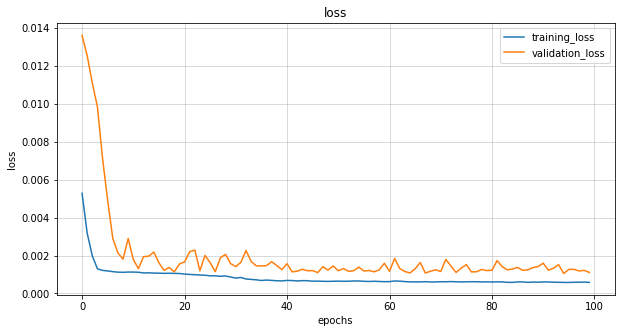

INFO:tensorflow:Assets written to: Unet_300epoch100\assets


In [9]:
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.0005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=100,batch_size = 10,validation_data=(X_test, Y_test),)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()
fig.savefig('lr=0.0005.png')
model.save('Unet_300epoch100')

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                           

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_14 (BatchN  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 ormalization)                                                                                    
                                                                                                  
 activation_14 (Activation)     (None, 32, 32, 512)  0           ['batch_normalization_14[0][0]'] 
                                                                                                  
 up_sampling2d_5 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_14[0][0]']          
                                                                                                  
 block7_co

80/80 [==============================] - 69s 859ms/step - loss: 6.0303e-04 - accuracy: 0.9385 - val_loss: 0.0013 - val_accuracy: 0.9060
Epoch 65/100
80/80 [==============================] - 69s 859ms/step - loss: 6.0010e-04 - accuracy: 0.9390 - val_loss: 0.0014 - val_accuracy: 0.8941
Epoch 66/100
80/80 [==============================] - 69s 858ms/step - loss: 6.1759e-04 - accuracy: 0.9370 - val_loss: 0.0014 - val_accuracy: 0.8986
Epoch 67/100
80/80 [==============================] - 69s 859ms/step - loss: 6.0471e-04 - accuracy: 0.9387 - val_loss: 0.0012 - val_accuracy: 0.9067
Epoch 68/100
80/80 [==============================] - 69s 859ms/step - loss: 6.1641e-04 - accuracy: 0.9379 - val_loss: 0.0011 - val_accuracy: 0.9122
Epoch 69/100
80/80 [==============================] - 69s 859ms/step - loss: 6.0045e-04 - accuracy: 0.9390 - val_loss: 0.0013 - val_accuracy: 0.9002
Epoch 70/100
80/80 [==============================] - 69s 858ms/step - loss: 6.2547e-04 - accuracy: 0.9363 - val_loss: 

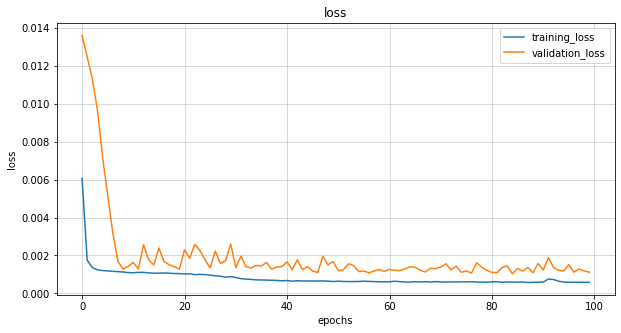

INFO:tensorflow:Assets written to: Unet_300epoch100_0.00005\assets


In [21]:
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.00005)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=100,batch_size = 10,validation_data=(X_test, Y_test),)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training_loss')
    plt.plot(plt_test, label='validation_loss')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()
fig.savefig('lr=0.00005.png')
model.save('Unet_300epoch100_0.00005')

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                           

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_14 (BatchN  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 ormalization)                                                                                    
                                                                                                  
 activation_14 (Activation)     (None, 32, 32, 512)  0           ['batch_normalization_14[0][0]'] 
                                                                                                  
 up_sampling2d_5 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_14[0][0]']          
                                                                                                  
 block7_co

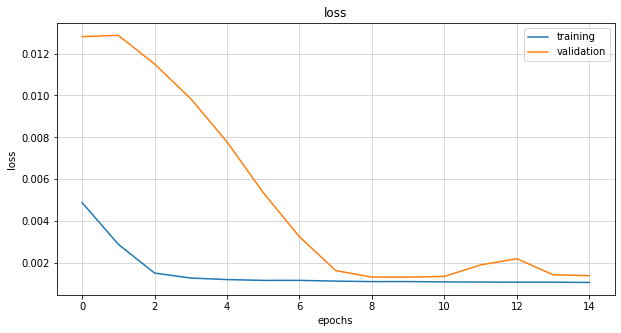

In [9]:
#UNet 結果
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.01)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 10,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training')
    plt.plot(plt_test, label='validation')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()
fig.savefig('model_loss300_lr0.01.png')

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                           

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_23 (BatchN  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 ormalization)                                                                                    
                                                                                                  
 activation_23 (Activation)     (None, 32, 32, 512)  0           ['batch_normalization_23[0][0]'] 
                                                                                                  
 up_sampling2d_9 (UpSampling2D)  (None, 64, 64, 512)  0          ['activation_23[0][0]']          
                                                                                                  
 block7_co

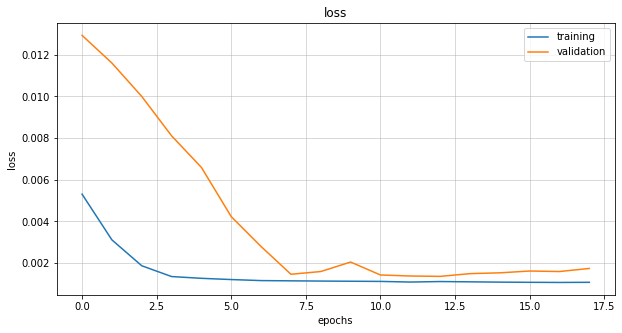

In [10]:
#UNet 結果
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.05)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 10,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training')
    plt.plot(plt_test, label='validation')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid(which='major',alpha=0.6)
    plt.grid(which='minor',alpha=0.3)
    plt.legend()
plt.show()
fig.savefig('model_loss300_lr0.05.png')

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 256, 256, 2  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1216        ['input_4[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                                )                                                           

                                                                                                  
 block6_conv3 (Conv2D)          (None, 32, 32, 512)  2359808     ['block6_conv2[0][0]']           
                                                                                                  
 batch_normalization_32 (BatchN  (None, 32, 32, 512)  2048       ['block6_conv3[0][0]']           
 ormalization)                                                                                    
                                                                                                  
 activation_32 (Activation)     (None, 32, 32, 512)  0           ['batch_normalization_32[0][0]'] 
                                                                                                  
 up_sampling2d_13 (UpSampling2D  (None, 64, 64, 512)  0          ['activation_32[0][0]']          
 )                                                                                                
          

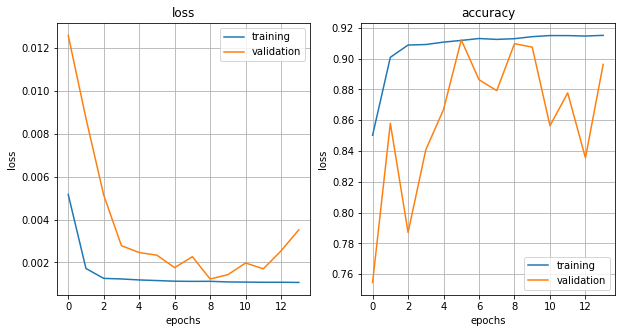

In [13]:
#UNet 結果(学習率を0.01，バッチサイズを８)→過学習顕著
model = UNet()
print(model.summary())
adam = tf.keras.optimizers.Adam(learning_rate=0.01)
model.compile(optimizer='adam',
              loss= 'mean_squared_error',
              metrics=['accuracy'])
fit_callbacs = [
        callbacks.EarlyStopping(monitor='val_loss',
                                patience=5,
                                mode='min')
    ]
history = model.fit(X_train,Y_train,epochs=20,batch_size = 8,validation_data=(X_test, Y_test),callbacks=fit_callbacs,)

#学習経過をグラフで表示
metrics = ['loss', 'accuracy']
fig=plt.figure(figsize=(10, 5))
for i in range(len(metrics)):
    metric = metrics[i]
    plt.subplot(1, 2, i+1)
    plt.title(metric)
    plt_train = history.history[metric]
    plt_test = history.history['val_' + metric]
    plt.plot(plt_train, label='training')
    plt.plot(plt_test, label='validation')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.grid()
    plt.legend()
plt.show()

## モデルの評価

In [22]:
score = model.evaluate(X_test,Y_test,verbose=0)
print('test xentropy:', score)

test xentropy: [0.001119981287047267, 0.9130850434303284]


## 推論

<Figure size 432x288 with 0 Axes>

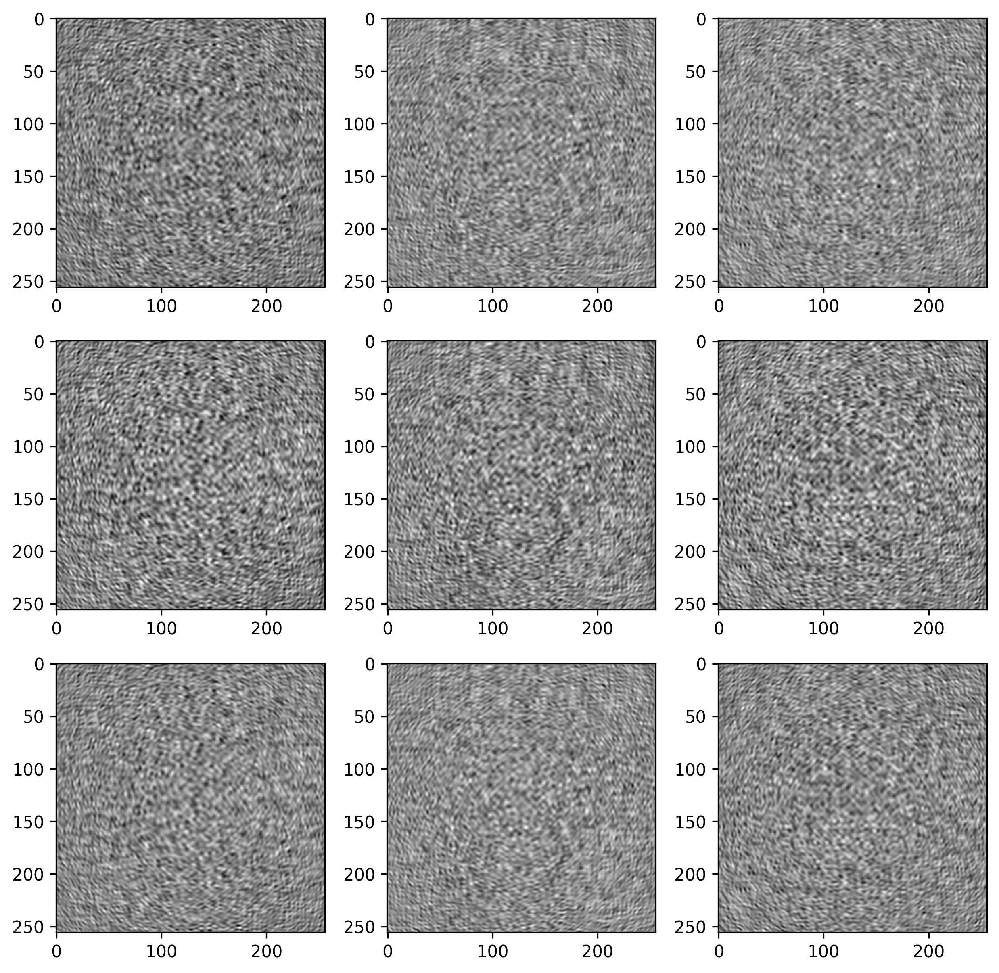

In [23]:
j = 160     #0<=j<=196
X_test_sampled = X_test[j:j+3]
X_test_sampled_pred = model.predict(X_test_sampled, verbose=0)
Y_test_sampled = Y_test[j:j+3]
#実部画像結果
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=300)
i = 0  #固定
for i in range(3):
    img_re = X_test_sampled[i,:,:,0]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = X_test_sampled_pred[i,:,:,0]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = Y_test_sampled[i,:,:,0]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

<Figure size 432x288 with 0 Axes>

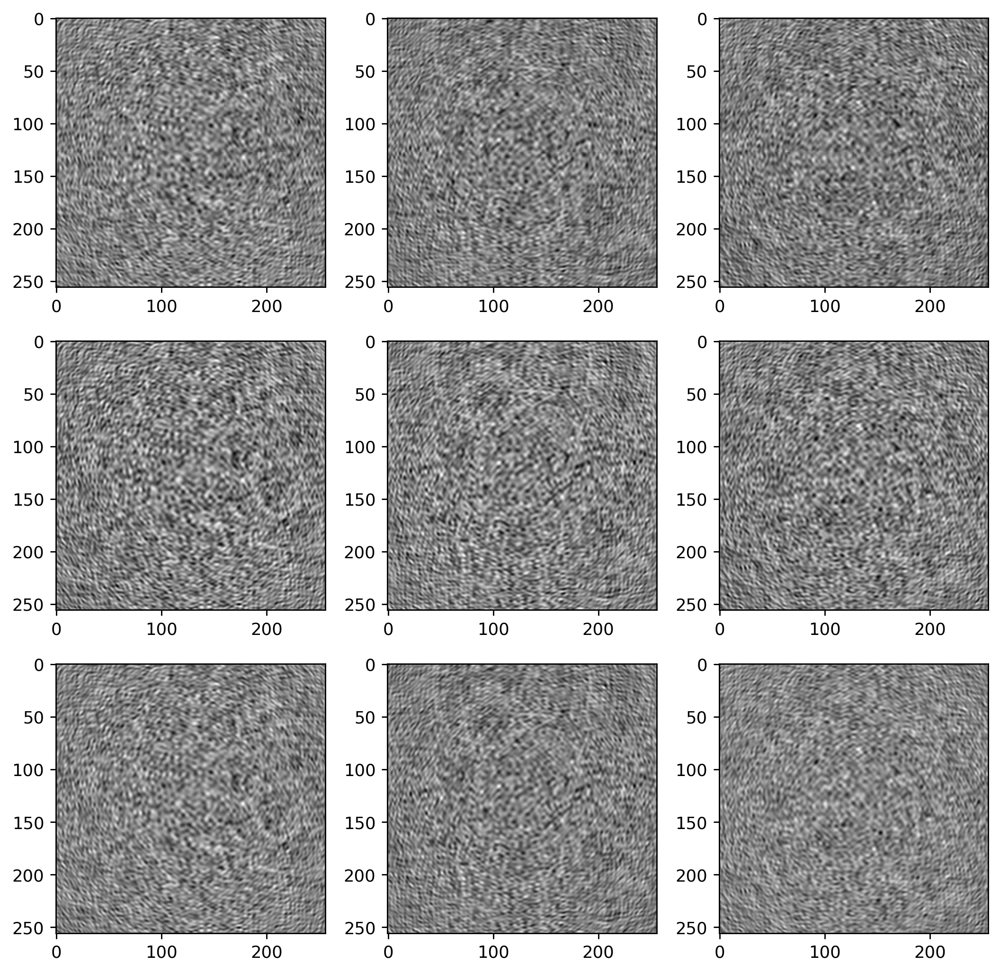

In [24]:
#虚部画像結果表示
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img_re = X_test_sampled[i,:,:,1]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = X_test_sampled_pred[i,:,:,1]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = Y_test_sampled[i,:,:,1]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

## 角スペクトル法による逆伝搬計算→再生像の表示

In [25]:
import custom_layers as cl

In [26]:
#PAS画像(実部、虚部の平均をそれぞれ引く)
for i in range(3):
    X_test_sampled[i,:,:,0] = X_test_sampled[i,:,:,0]-np.mean(X_test_sampled[i,:,:,0])
    X_test_sampled[i,:,:,1] = X_test_sampled[i,:,:,1]-np.mean(X_test_sampled[i,:,:,1])

In [27]:
#推論画像(実部、虚部の平均をそれぞれ引く)
for i in range(3):
    X_test_sampled_pred[i,:,:,0] = X_test_sampled_pred[i,:,:,0]-np.mean(X_test_sampled_pred[i,:,:,0])
    X_test_sampled_pred[i,:,:,1] = X_test_sampled_pred[i,:,:,1]-np.mean(X_test_sampled_pred[i,:,:,1])

In [28]:
#テスト用画像(実部、虚部の平均をそれぞれ引く)
for i in range(3):
    Y_test_sampled[i,:,:,0] = Y_test_sampled[i,:,:,0]-np.mean(Y_test_sampled[i,:,:,0])
    Y_test_sampled[i,:,:,1] = Y_test_sampled[i,:,:,1]-np.mean(Y_test_sampled[i,:,:,1])

In [29]:
k = cl.Diffract((3,256,256,2),wl=520e-9,p=8e-6,z= -0.1)
S1 = k(X_test_sampled)         #PASホログラム画像再生
S2 = k(X_test_sampled_pred)    #PAS画質改善ホログラム画像再生
S3 = k(Y_test_sampled)         #CGH画像再生

<Figure size 432x288 with 0 Axes>

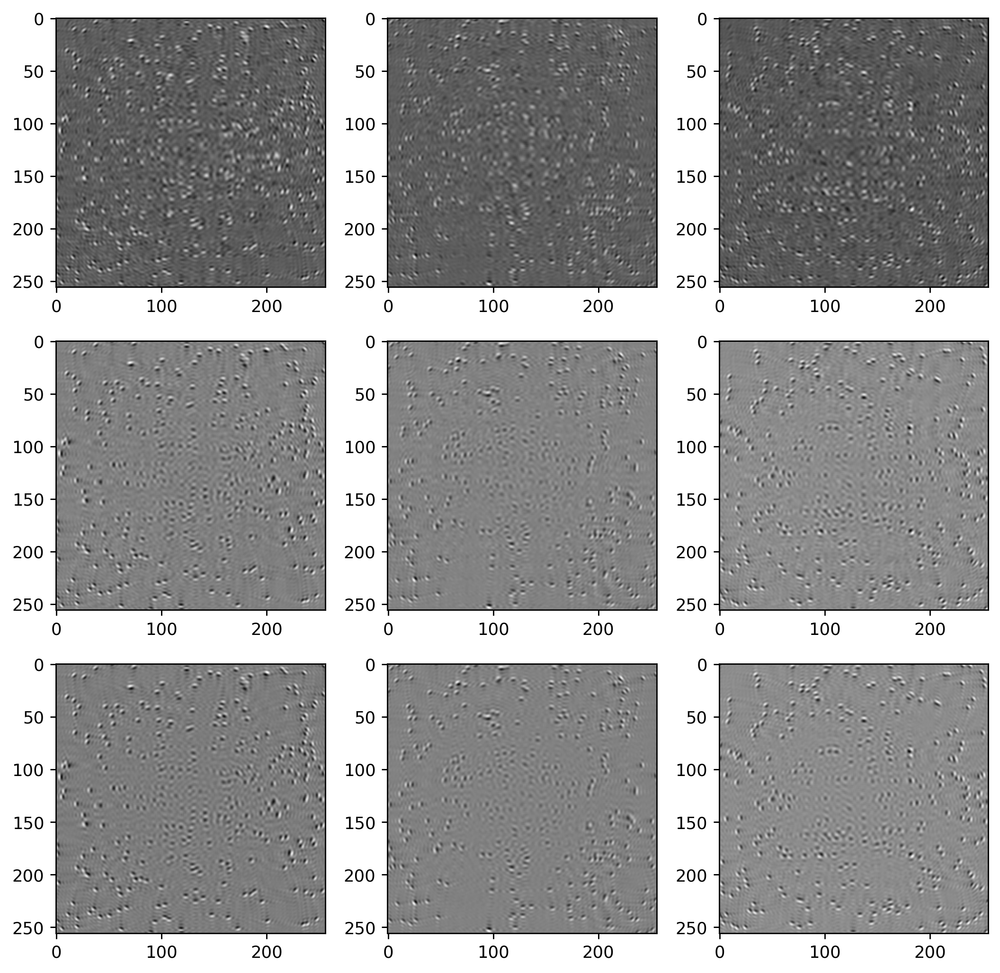

In [30]:
#再生計算画像表示(実部)
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img_re = S1[i,:,:,0]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = S2[i,:,:,0]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = S3[i,:,:,0]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

<Figure size 432x288 with 0 Axes>

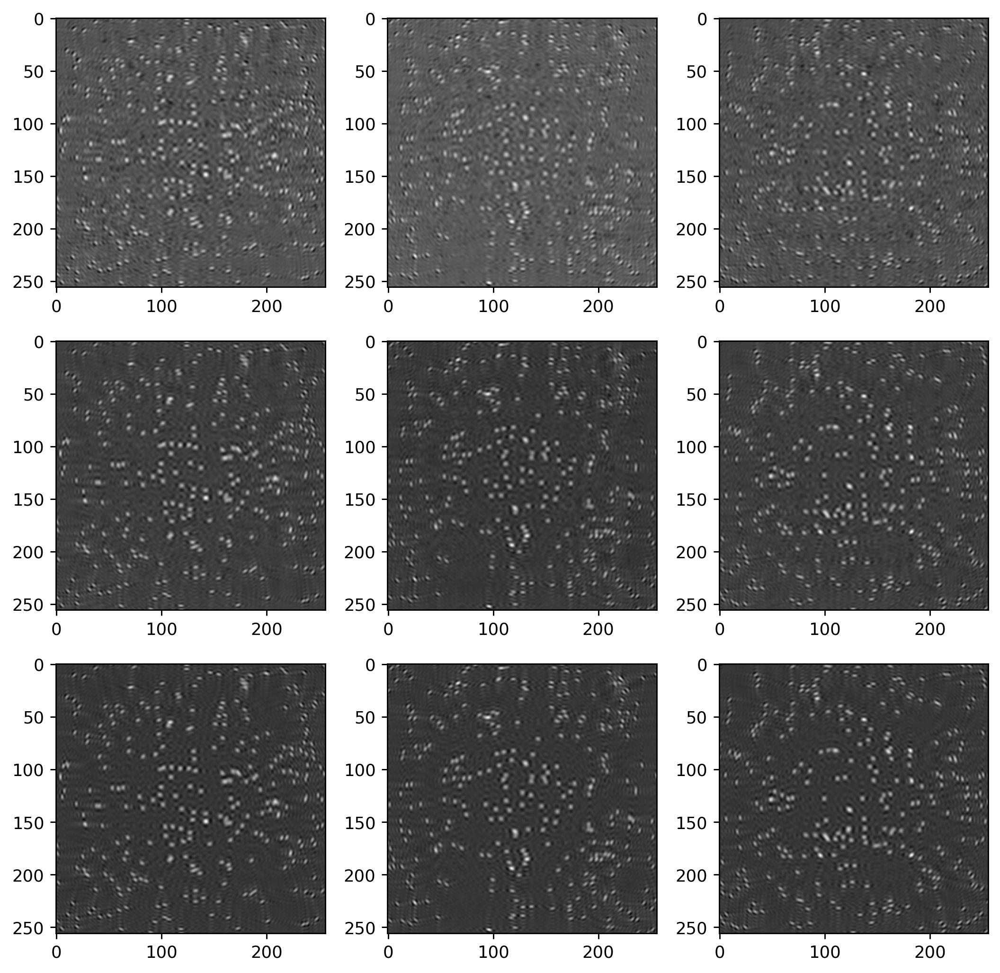

In [31]:
#再生計算画像表示(虚部)
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img_re = S1[i,:,:,1]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = S2[i,:,:,1]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = S3[i,:,:,1]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

<Figure size 432x288 with 0 Axes>

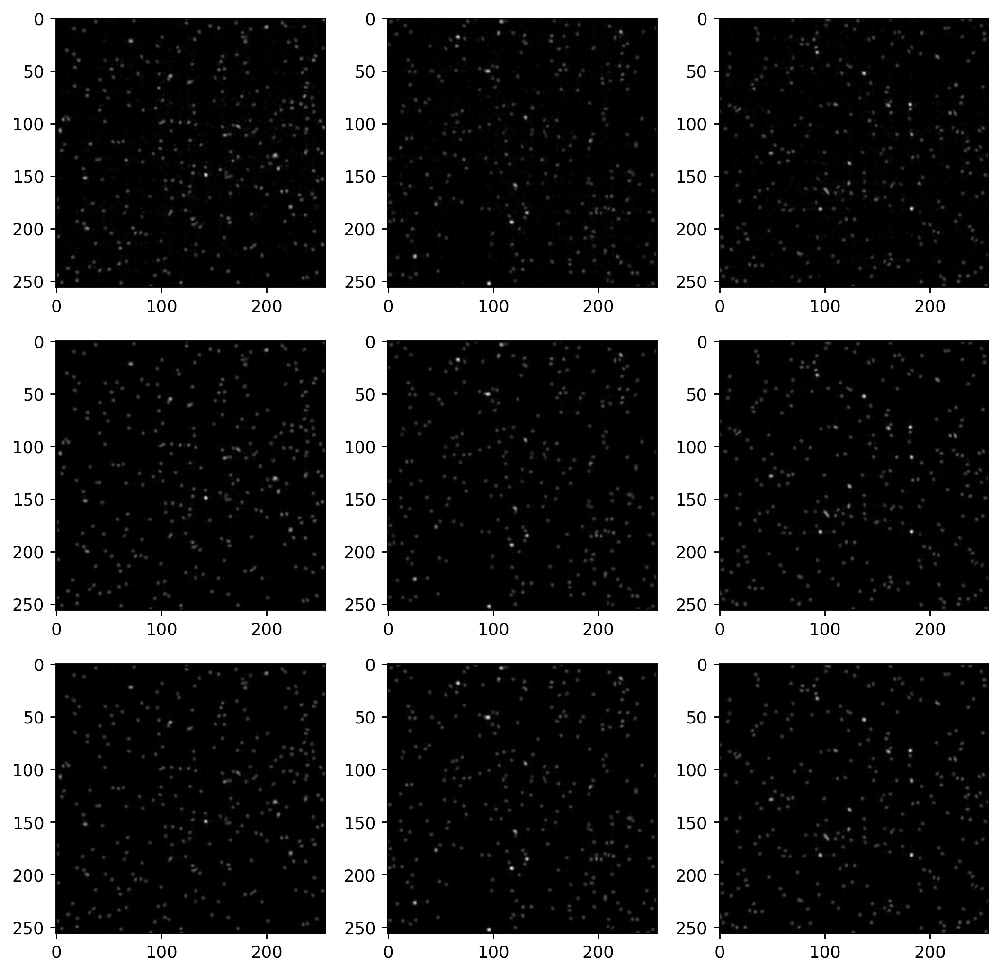

In [32]:
#光強度表示(上から、PAS,推論画像,CGH)
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img = tf.math.pow(S1[i,:,:,0],2) + tf.math.pow(S1[i,:,:,1],2)
    fig.add_subplot(3,3,i+1)
    plt.imshow(img, cmap='gray')
    
    pred_img = tf.math.pow(S2[i,:,:,0],2) + tf.math.pow(S2[i,:,:,1],2)
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img, cmap='gray')
    
    correct_img = tf.math.pow(S3[i,:,:,0],2) + tf.math.pow(S3[i,:,:,1],2)
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img, cmap='gray')

In [44]:
model.save('U-net300_model')

INFO:tensorflow:Assets written to: U-net300_model\assets


In [45]:
import random
def pcloudset(k,p):
    data_list = []
    for l in range(k):
        lists = []
        for i in range(p):
            rondom_list = []
            for k in range(2):
                xy = random.uniform(-pp/2*res[0],pp/2*res[1])
                rondom_list.append(xy)
            rondom_list.append(z)
            lists.append(rondom_list)
            pcloud = np.array(lists,dtype = np.float32)
            pcloud += [pp/2*res[0], pp/2*res[1], 0];
        data_list.append(pcloud)
        pcloudset = np.array(data_list)
    return pcloudset

In [48]:
P = pcloudset(3,300)

In [47]:
#ホログラムパラメータ(cube284のパラメータに合わせる)
res = (256, 256)  # hologram resolution (in pixels)
pp = 8e-6           # pixel pitch (in m)
wlen = 520e-9       # wavelength (in m)
B = 32;             # block size
F = 4;    # scaling factor (multiple of block size: effective FFT block size = B*F)
z = 0.1

In [49]:
print(P.shape)

(3, 300, 3)


In [50]:
#CGH画像　3枚用意
REF1 = dalgo.reference_fresnel_CGH(res, pp, wlen, pcloud=P[0])
REF2 = dalgo.reference_fresnel_CGH(res, pp, wlen, pcloud=P[1])
REF3 = dalgo.reference_fresnel_CGH(res, pp, wlen, pcloud=P[2])

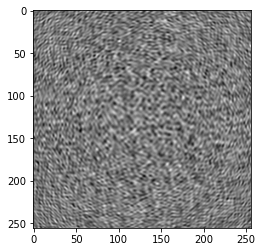

In [51]:
plt.imshow(tf.math.real(REF1),cmap='gray')

In [52]:
import cv2

In [64]:
#正解画像(CGH1)生成
CGH1_re = tf.math.real(REF1)
CGH1_re = CGH1_re.numpy()
CGH1_re = (CGH1_re-np.min(CGH1_re))/(np.max(CGH1_re)-np.min(CGH1_re))*255
cv2.imwrite('./CGH_point300/CGH1_re.png',CGH1_re)

True

In [65]:
#正解画像(CGH1)生成
CGH1_im = tf.math.imag(REF1)
CGH1_im = CGH1_im.numpy()
CGH1_im = (CGH1_im-np.min(CGH1_im))/(np.max(CGH1_im)-np.min(CGH1_im))*255
cv2.imwrite('./CGH_point300/CGH1_im.png',CGH1_im)

True

In [66]:
#正解画像(CGH2)生成
CGH2_re = tf.math.real(REF2)
CGH2_re = CGH2_re.numpy()
CGH2_re = (CGH2_re-np.min(CGH2_re))/(np.max(CGH2_re)-np.min(CGH2_re))*255
cv2.imwrite('./CGH_point300/CGH2_re.png',CGH2_re)

True

In [67]:
#正解画像(CGH2)生成
CGH2_im = tf.math.imag(REF2)
CGH2_im = CGH2_im.numpy()
CGH2_im = (CGH2_im-np.min(CGH2_im))/(np.max(CGH2_im)-np.min(CGH2_im))*255
cv2.imwrite('./CGH_point300/CGH2_im.png',CGH2_im)

True

In [68]:
#正解画像(CGH3)生成
CGH3_re = tf.math.real(REF3)
CGH3_re = CGH3_re.numpy()
CGH3_re = (CGH3_re-np.min(CGH3_re))/(np.max(CGH3_re)-np.min(CGH3_re))*255
cv2.imwrite('./CGH_point300/CGH3_re.png',CGH3_re)

True

In [69]:
#正解画像(CGH3)生成
CGH3_im = tf.math.imag(REF3)
CGH3_im = CGH3_im.numpy()
CGH3_im = (CGH3_im-np.min(CGH3_im))/(np.max(CGH3_im)-np.min(CGH3_im))*255
cv2.imwrite('./CGH_point300/CGH3_im.png',CGH3_im)

True

In [70]:
#入力画像(PAS)を3枚用意
APAS1 = dalgo.accurate_fresnel_stereogram(res, B, F, pp, wlen, pcloud=P[0])
APAS1 = dalgo.inverse_stft(APAS1, B)
APAS2 = dalgo.accurate_fresnel_stereogram(res, B, F, pp, wlen, pcloud=P[1])
APAS2 = dalgo.inverse_stft(APAS2, B)
APAS3 = dalgo.accurate_fresnel_stereogram(res, B, F, pp, wlen, pcloud=P[2])
APAS3 = dalgo.inverse_stft(APAS3, B)

In [71]:
PAS1_re = tf.math.real(APAS1)
PAS1_re = PAS1_re.numpy()
PAS1_re = (PAS1_re-np.min(PAS1_re))/(np.max(PAS1_re)-np.min(PAS1_re))*255
cv2.imwrite('./PAS_point300/PAS1_re.png',PAS1_re)

True

In [72]:
PAS1_im = tf.math.imag(APAS1)
PAS1_im = PAS1_im.numpy()
PAS1_im = (PAS1_im-np.min(PAS1_im))/(np.max(PAS1_im)-np.min(PAS1_im))*255
cv2.imwrite('./PAS_point300/PAS1_im.png',PAS1_im)

True

In [73]:
PAS2_re = tf.math.real(APAS2)
PAS2_re = PAS2_re.numpy()
PAS2_re = (PAS2_re-np.min(PAS2_re))/(np.max(PAS2_re)-np.min(PAS2_re))*255
cv2.imwrite('./PAS_point300/PAS2_re.png',PAS2_re)

True

In [74]:
PAS2_im = tf.math.imag(APAS2)
PAS2_im = PAS2_im.numpy()
PAS2_im = (PAS2_im-np.min(PAS2_im))/(np.max(PAS2_im)-np.min(PAS2_im))*255
cv2.imwrite('./PAS_point300/PAS2_im.png',PAS2_im)

True

In [75]:
PAS3_re = tf.math.real(APAS3)
PAS3_re = PAS3_re.numpy()
PAS3_re = (PAS3_re-np.min(PAS3_re))/(np.max(PAS3_re)-np.min(PAS3_re))*255
cv2.imwrite('./PAS_point300/PAS3_re.png',PAS3_re)

True

In [76]:
PAS3_im = tf.math.imag(APAS3)
PAS3_im = PAS3_im.numpy()
PAS3_im = (PAS3_im-np.min(PAS3_im))/(np.max(PAS3_im)-np.min(PAS3_im))*255
cv2.imwrite('./PAS_point300/PAS3_im.png',PAS3_im)

True

In [77]:
a = tf.math.real(APAS1)
a = (a-np.min(a))/(np.max(a)-np.min(a))
b =  tf.math.imag(APAS1)
b = (b-np.min(b))/(np.max(b)-np.min(b))
c = tf.math.real(APAS2)
c = (c-np.min(c))/(np.max(c)-np.min(c))
d =  tf.math.imag(APAS2)
d = (d-np.min(d))/(np.max(d)-np.min(d))
e = tf.math.real(APAS3)
e = (e-np.min(e))/(np.max(e)-np.min(e))
f = tf.math.imag(APAS3)
f = (f-np.min(f))/(np.max(f)-np.min(f))

In [78]:
X_sample = np.zeros((3,256,256,2),dtype=np.float32)
X_sample[0,:,:,0] = a
X_sample[0,:,:,1] = b
X_sample[1,:,:,0] = c
X_sample[1,:,:,1] = d
X_sample[2,:,:,0] = e
X_sample[2,:,:,1] = f
X_sample = tf.add(X_sample,0)
print(X_sample)

tf.Tensor(
[[[[0.4929161  0.5925567 ]
   [0.45528737 0.5855846 ]
   [0.50602496 0.6130186 ]
   ...
   [0.41907912 0.60091597]
   [0.4201827  0.5250639 ]
   [0.45709577 0.50074816]]

  [[0.5015199  0.45710534]
   [0.40508786 0.5442344 ]
   [0.47175324 0.5691531 ]
   ...
   [0.51725435 0.54663575]
   [0.5516475  0.5810586 ]
   [0.51048654 0.62635934]]

  [[0.4164011  0.39786968]
   [0.36070186 0.5998899 ]
   [0.46791488 0.62907356]
   ...
   [0.50249654 0.50251293]
   [0.60172695 0.4878039 ]
   [0.6219795  0.61743075]]

  ...

  [[0.42502996 0.44923353]
   [0.407392   0.5438888 ]
   [0.4526527  0.5887907 ]
   ...
   [0.6010266  0.4717921 ]
   [0.5489151  0.5221613 ]
   [0.5395286  0.48092932]]

  [[0.5107646  0.41067854]
   [0.38731277 0.43874454]
   [0.35582232 0.57487166]
   ...
   [0.65701014 0.69969094]
   [0.52501726 0.74269205]
   [0.45547837 0.6568933 ]]

  [[0.5736742  0.4994307 ]
   [0.50591874 0.35999754]
   [0.3357137  0.3964718 ]
   ...
   [0.44217005 0.83603114]
   [0.285643

In [79]:
Y_sample = np.zeros((3,256,256,2),dtype=np.float32)
Y_sample[0,:,:,0] = (tf.math.real(REF1)-np.min(tf.math.real(REF1)))/(np.max(tf.math.real(REF1))-np.min(tf.math.real(REF1)))
Y_sample[0,:,:,1] = (tf.math.imag(REF1)-np.min(tf.math.imag(REF1)))/(np.max(tf.math.imag(REF1))-np.min(tf.math.imag(REF1)))
Y_sample[1,:,:,0] = (tf.math.real(REF2)-np.min(tf.math.real(REF2)))/(np.max(tf.math.real(REF2))-np.min(tf.math.real(REF2)))
Y_sample[1,:,:,1] = (tf.math.imag(REF2)-np.min(tf.math.imag(REF2)))/(np.max(tf.math.imag(REF2))-np.min(tf.math.imag(REF2)))
Y_sample[2,:,:,0] = (tf.math.real(REF3)-np.min(tf.math.real(REF3)))/(np.max(tf.math.real(REF3))-np.min(tf.math.real(REF3)))
Y_sample[2,:,:,1] = (tf.math.imag(REF3)-np.min(tf.math.imag(REF3)))/(np.max(tf.math.imag(REF3))-np.min(tf.math.imag(REF3)))
Y_sample = tf.add(Y_sample,0)

In [80]:
X_pred = model.predict(X_sample, verbose=0)

<Figure size 432x288 with 0 Axes>

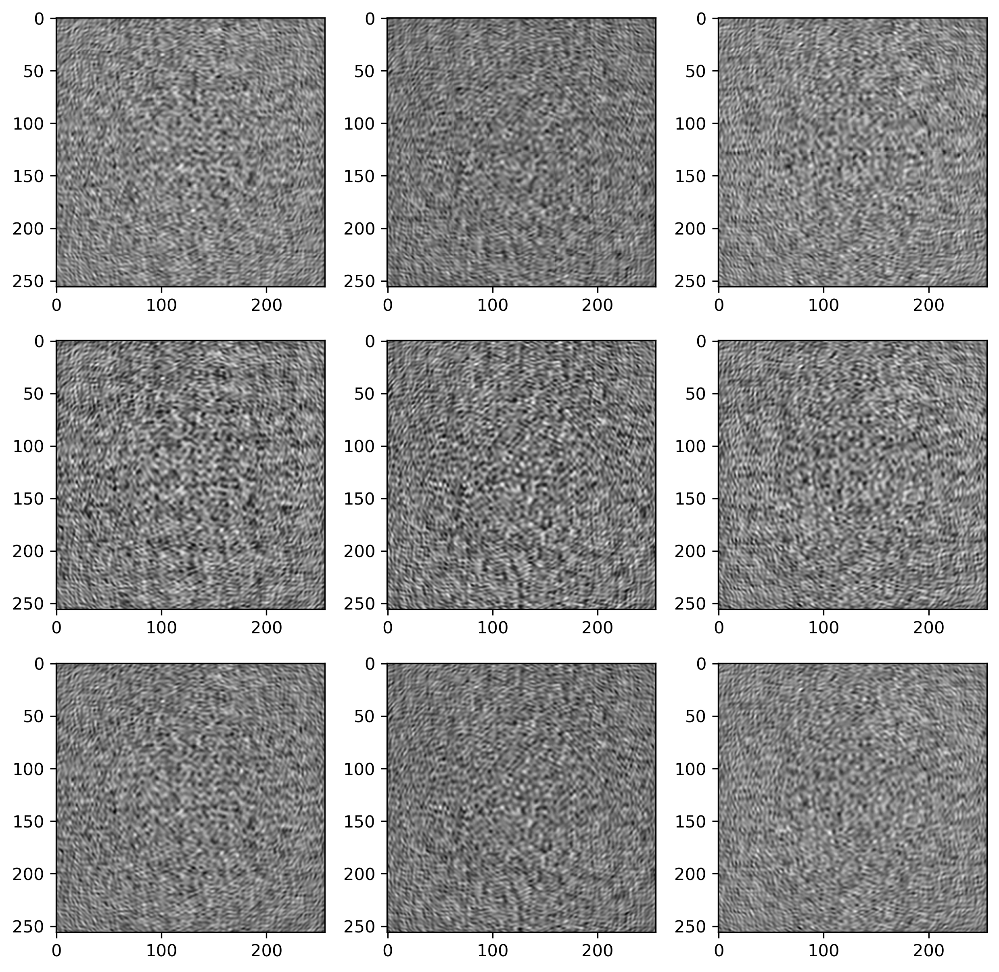

In [81]:
#実部画像結果
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=300)
i = 0  #固定
for i in range(3):
    img_re = X_sample[i,:,:,0]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = X_pred[i,:,:,0]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = Y_sample[i,:,:,0]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

<Figure size 432x288 with 0 Axes>

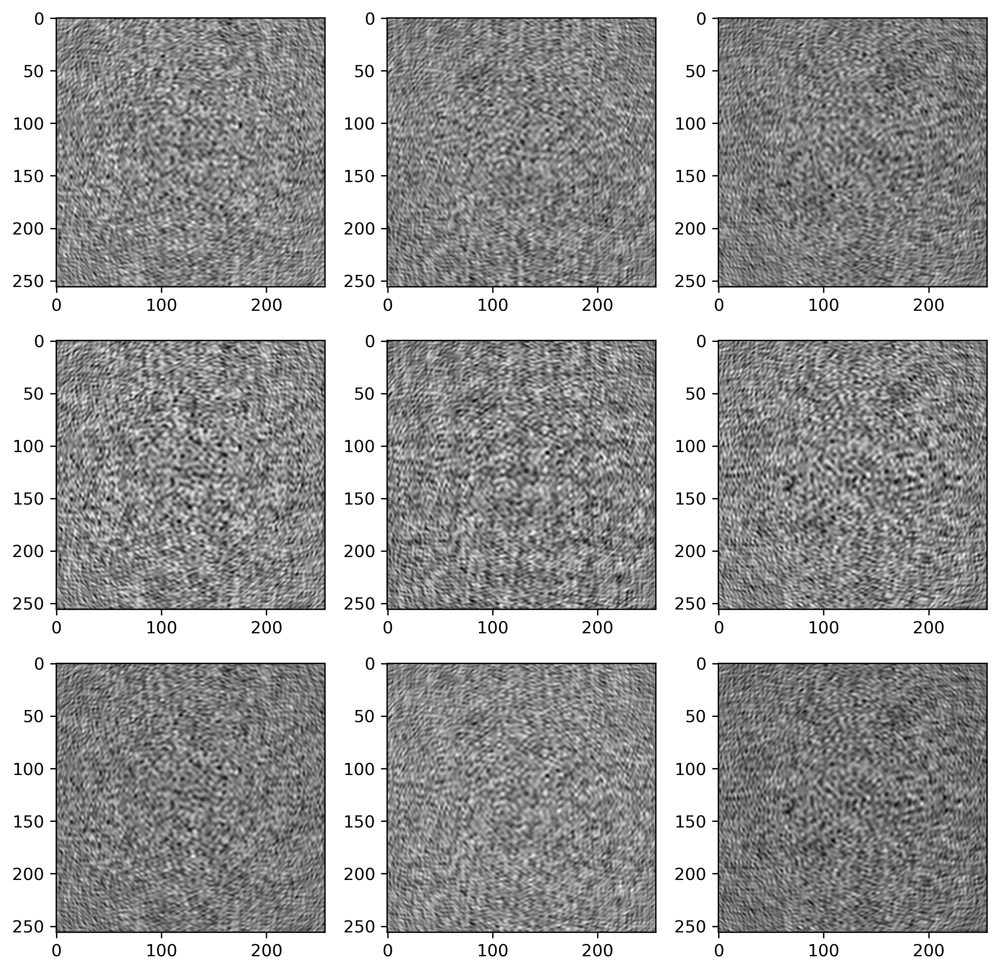

In [82]:
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=300)
i = 0  #固定
for i in range(3):
    img_re = X_sample[i,:,:,1]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = X_pred[i,:,:,1]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = Y_sample[i,:,:,1]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

In [93]:
#PAS画像(実部、虚部の平均をそれぞれ引く)
for i in range(3):
    X_sample[i,:,:,0] = X_sample[i,:,:,0]-np.mean(X_sample[i,:,:,0])
    X_sample[i,:,:,1] = X_sample[i,:,:,1]-np.mean(X_sample[i,:,:,1])

In [94]:
#推論画像(実部、虚部の平均をそれぞれ引く)
for i in range(3):
    X_pred[i,:,:,0] = X_pred[i,:,:,0]-np.mean(X_pred[i,:,:,0])
    X_pred[i,:,:,1] = X_pred[i,:,:,1]-np.mean(X_pred[i,:,:,1])

In [96]:
Y_sample = Y_sample.numpy()

In [97]:
#テスト用画像(実部、虚部の平均をそれぞれ引く)
for i in range(3):
    Y_sample[i,:,:,0] = Y_sample[i,:,:,0]-np.mean(Y_sample[i,:,:,0])
    Y_sample[i,:,:,1] = Y_sample[i,:,:,1]-np.mean(Y_sample[i,:,:,1])

In [98]:
import custom_layers as cl

In [99]:
k = cl.Diffract((3,256,256,2),wl=520e-9,p=8e-6,z= -0.1)
S1 = k(X_sample)         #PASホログラム画像再生
S2 = k(X_pred)    #PAS画質改善ホログラム画像再生
S3 = k(Y_sample)         #CGH画像再生

<Figure size 432x288 with 0 Axes>

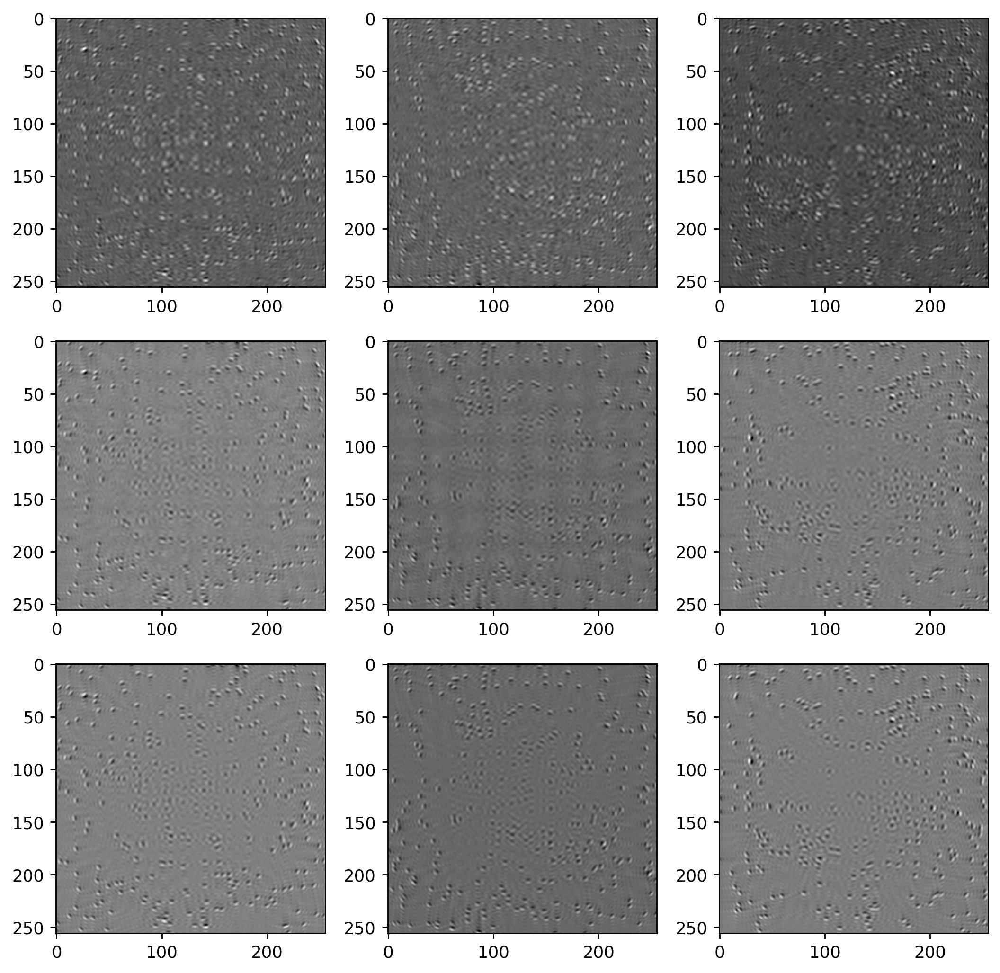

In [100]:
#再生計算画像表示(実部)
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img_re = S1[i,:,:,0]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = S2[i,:,:,0]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = S3[i,:,:,0]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

<Figure size 432x288 with 0 Axes>

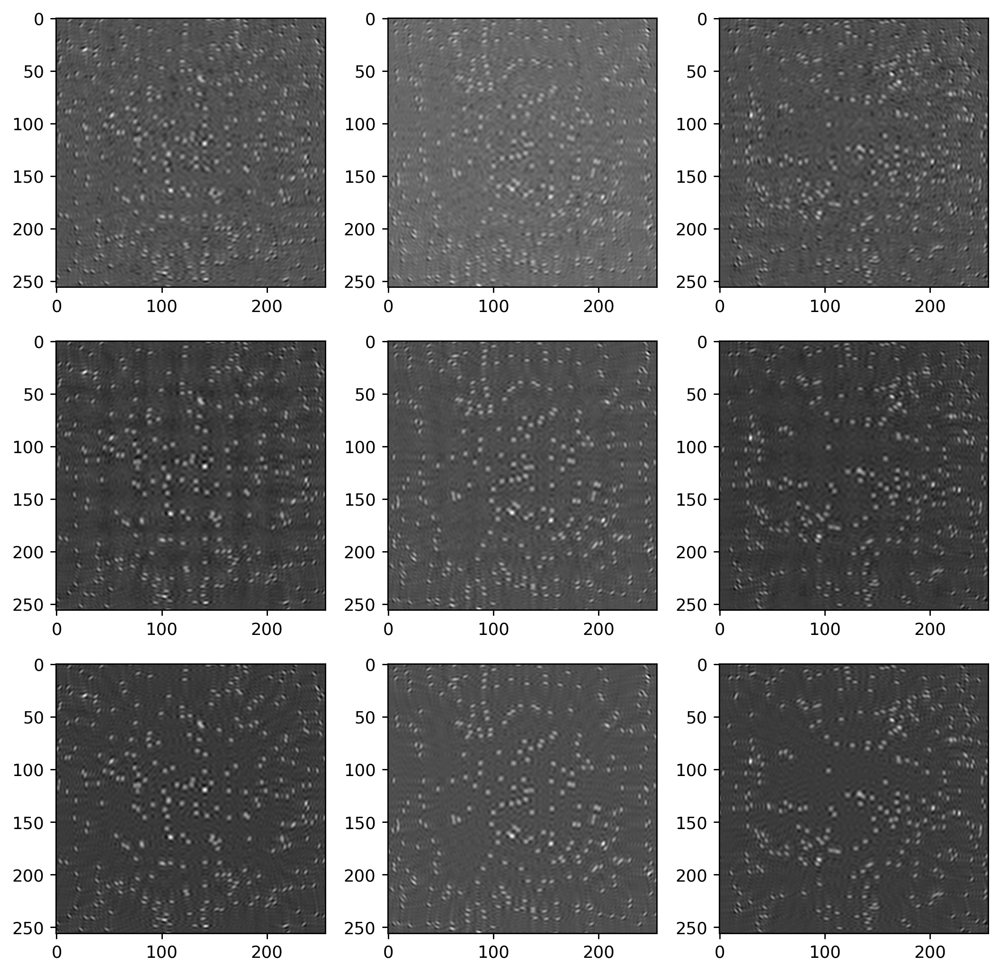

In [101]:
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img_re = S1[i,:,:,1]
    fig.add_subplot(3,3,i+1)
    plt.imshow(img_re, cmap='gray')
    
    pred_img_re = S2[i,:,:,1]
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img_re, cmap='gray')
    
    correct_img_re = S3[i,:,:,1]
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img_re, cmap='gray')

<Figure size 432x288 with 0 Axes>

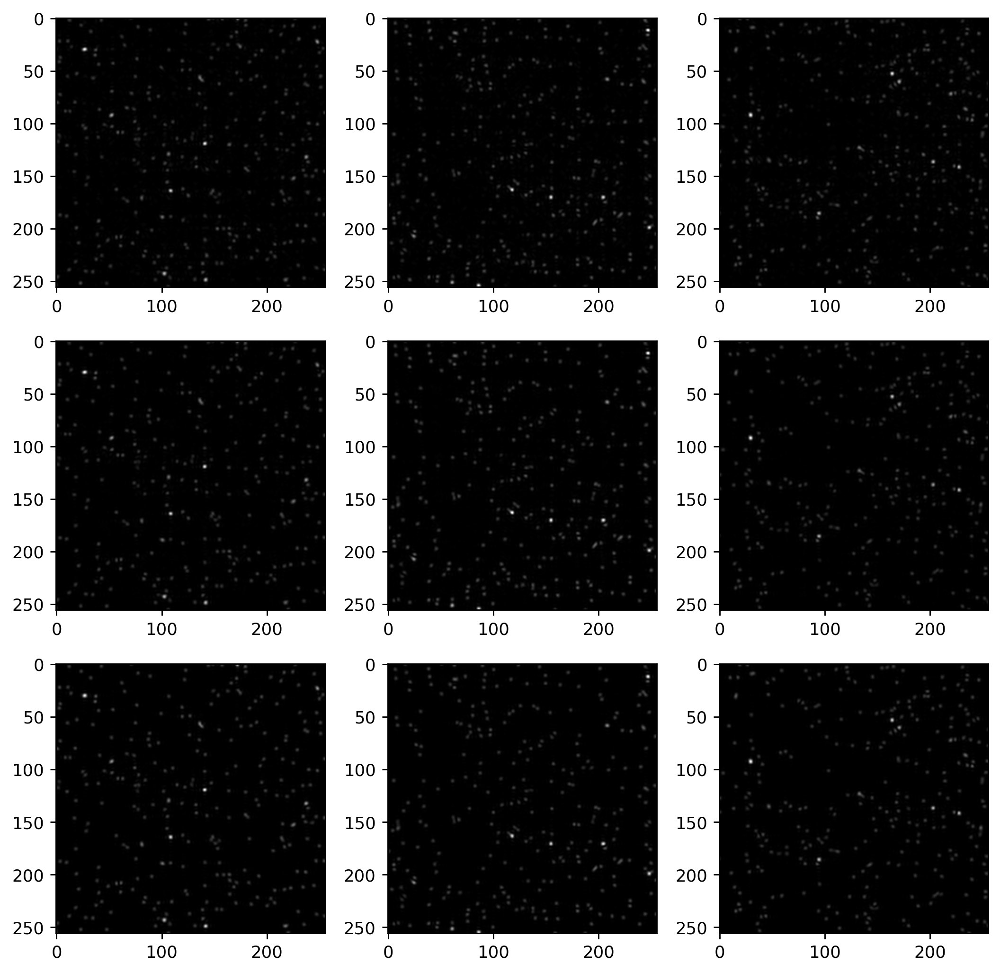

In [102]:
#光強度表示(上から、PAS,推論画像,CGH)
fig = plt.figure()
fig = plt.figure(figsize=(10,10),dpi=256)
for i in range(3):
    img = tf.math.pow(S1[i,:,:,0],2) + tf.math.pow(S1[i,:,:,1],2)
    fig.add_subplot(3,3,i+1)
    plt.imshow(img, cmap='gray')
    
    pred_img = tf.math.pow(S2[i,:,:,0],2) + tf.math.pow(S2[i,:,:,1],2)
    fig.add_subplot(3,3,i+4)
    plt.imshow(pred_img, cmap='gray')
    
    correct_img = tf.math.pow(S3[i,:,:,0],2) + tf.math.pow(S3[i,:,:,1],2)
    fig.add_subplot(3,3,i+7)
    plt.imshow(correct_img, cmap='gray')

In [103]:
#APASの再生画像
PAS_I1 = tf.math.pow(S1[0,:,:,0],2) + tf.math.pow(S1[0,:,:,1],2)
PAS_I1 =  PAS_I1.numpy()
PAS_I1 = (PAS_I1-np.min(PAS_I1))/(np.max(PAS_I1)-np.min(PAS_I1))*255
cv2.imwrite('./PAS_point300/PAS_I1.png',PAS_I1)

PAS_I2 = tf.math.pow(S1[1,:,:,0],2) + tf.math.pow(S1[1,:,:,1],2)
PAS_I2 = PAS_I2.numpy()
PAS_I2 = (PAS_I2-np.min(PAS_I2))/(np.max(PAS_I2)-np.min(PAS_I2))*255
cv2.imwrite('./PAS_point300/PAS_I2.png',PAS_I2)

PAS_I3 = tf.math.pow(S1[2,:,:,0],2) + tf.math.pow(S1[2,:,:,1],2)
PAS_I3 = PAS_I3.numpy()
PAS_I3 = (PAS_I3-np.min(PAS_I3))/(np.max(PAS_I3)-np.min(PAS_I3))*255
cv2.imwrite('./PAS_point300/PAS_I3.png',PAS_I3)

True

In [104]:
#推論の再生画像
pred_I1 = tf.math.pow(S2[0,:,:,0],2) + tf.math.pow(S2[0,:,:,1],2)
pred_I1 =  pred_I1.numpy()
pred_I1 = (pred_I1-np.min(pred_I1))/(np.max(pred_I1)-np.min(pred_I1))*255
cv2.imwrite('./prediction_point300/pred_I1.png',pred_I1)

pred_I2 = tf.math.pow(S2[1,:,:,0],2) + tf.math.pow(S2[1,:,:,1],2)
pred_I2 = pred_I2.numpy()
pred_I2 = (pred_I2-np.min(pred_I2))/(np.max(pred_I2)-np.min(pred_I2))*255
cv2.imwrite('./prediction_point300/pred_I2.png',pred_I2)

pred_I3 = tf.math.pow(S2[2,:,:,0],2) + tf.math.pow(S2[2,:,:,1],2)
pred_I3 = pred_I3.numpy()
pred_I3 = (pred_I3-np.min(pred_I3))/(np.max(pred_I3)-np.min(pred_I3))*255
cv2.imwrite('./prediction_point300/pred_I3.png',pred_I3)

True

In [105]:
#CGHの再生画像
CGH_I1 = tf.math.pow(S3[0,:,:,0],2) + tf.math.pow(S3[0,:,:,1],2)
CGH_I1 =  CGH_I1.numpy()
CGH_I1 = (CGH_I1-np.min(CGH_I1))/(np.max(CGH_I1)-np.min(CGH_I1))*255
cv2.imwrite('./CGH_point300/CGH_I1.png',CGH_I1)

CGH_I2 = tf.math.pow(S3[1,:,:,0],2) + tf.math.pow(S3[1,:,:,1],2)
CGH_I2 = CGH_I2.numpy()
CGH_I2 = (CGH_I2-np.min(CGH_I2))/(np.max(CGH_I2)-np.min(CGH_I2))*255
cv2.imwrite('./CGH_point300/CGH_I2.png',CGH_I2)

CGH_I3 = tf.math.pow(S3[2,:,:,0],2) + tf.math.pow(S3[2,:,:,1],2)
CGH_I3 = CGH_I3.numpy()
CGH_I3 = (CGH_I3-np.min(CGH_I3))/(np.max(CGH_I3)-np.min(CGH_I3))*255
cv2.imwrite('./CGH_point300/CGH_I3.png',CGH_I3)

True

In [83]:
#推論1
pred1_re = X_pred[0,:,:,0]
pred1_re = (pred1_re-np.min(pred1_re))/(np.max(pred1_re)-np.min(pred1_re))*255
cv2.imwrite('./prediction_point300/pred1_re.png',pred1_re)
pred1_im = X_pred[0,:,:,1]
pred1_im = (pred1_im-np.min(pred1_im))/(np.max(pred1_im)-np.min(pred1_im))*255
cv2.imwrite('./prediction_point300/pred1_im.png',pred1_im)

True

In [84]:
#推論2
pred2_re = X_pred[1,:,:,0]
pred2_re = (pred2_re-np.min(pred2_re))/(np.max(pred2_re)-np.min(pred2_re))*255
cv2.imwrite('./prediction_point300/pred2_re.png',pred2_re)
pred2_im = X_pred[1,:,:,1]
pred2_im = (pred2_im-np.min(pred2_im))/(np.max(pred2_im)-np.min(pred2_im))*255
cv2.imwrite('./prediction_point300/pred2_im.png',pred2_im)

True

In [85]:
#推論3
pred3_re = X_pred[2,:,:,0]
pred3_re = (pred3_re-np.min(pred3_re))/(np.max(pred3_re)-np.min(pred3_re))*255
cv2.imwrite('./prediction_point300/pred3_re.png',pred3_re)
pred3_im = X_pred[2,:,:,1]
pred3_im = (pred2_im-np.min(pred2_im))/(np.max(pred2_im)-np.min(pred2_im))*255
cv2.imwrite('./prediction_point300/pred3_im.png',pred3_im)

True